**This notebook use information from** <br/>
https://www.tensorflow.org/tutorials/audio/music_generation?hl=zh-cn <br/>
and <br/>
https://www.kaggle.com/code/karnikakapoor/music-generation-lstm/notebook

## import libraries

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory


# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

#Installing dependencies
# !pip install music21
# !apt-get install -y lilypond
# !winget install -y lilypond

In [2]:
import tensorflow 
import numpy as np
import os
import pandas as pd 
from collections import Counter
import random
import IPython
from IPython.display import Image, Audio
import music21
from music21 import *
import music21 as m21
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers import Adamax
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import sys
import pathlib
import warnings

import collections
import datetime
import fluidsynth
import glob
import pathlib
import pretty_midi
import seaborn as sns
import tensorflow as tf
from midi2audio import FluidSynth
# from IPython import display
from typing import Dict, List, Optional, Sequence, Tuple

warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")
np.random.seed(42)

2023-08-05 00:26:26.750650: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-08-05 00:26:27.238009: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## Load Data

In [3]:
#Loading the list of mozart's midi files as stream 
filepath = "datasets/mozart/"
#Getting midi files
all_midis= []
for i in os.listdir(filepath):
    if i.endswith(".mid"):
        tr = filepath+i
        midi = converter.parse(tr)  #use music21.converter.parse() method to parse MIDI files into music streams 
        all_midis.append(midi)

In [4]:
#Function to get the notes
      
def extract_notes(file):
    notes = [] # It initialized an empty list called 'notes', which will store the individual notes and chords
    pick = None
    for j in file:
        songs = instrument.partitionByInstrument(j) #It uses the instrument.partitionByInstrument() method to identify different parts of the music, such as separate instruments or voices.
        for part in songs.parts: 
            pick = part.recurse()#uses part.recurse() to traverse all elements in that part, such as notes, chords, and rests
            for element in pick:
                if isinstance(element, note.Note):
                    notes.append(str(element.pitch))
                elif isinstance(element, chord.Chord):
                    notes.append(".".join(str(n) for n in element.normalOrder))
 #For each element, it checks its type using isinstance() and, if it's a single note (note.Note), it appends its pitch to the notes list. 
 #If it's a chord (chord.Chord), it appends the chord pitches as a dot-separated string to the notes list.
    return notes
#Getting the list of notes as Corpus
Corpus= extract_notes(all_midis)
print("Total notes in all the Mozart midis in the dataset:", len(Corpus))

Total notes in all the Mozart midis in the dataset: 55802


## data exploration

In [5]:
print("First fifty values in the Corpus:", Corpus[:50])

First fifty values in the Corpus: ['B-4', 'B-3', 'F4', 'D4', 'F4', 'D5', 'B-3', '2.3', 'F4', 'C5', 'D5', 'D4', 'E-5', 'F4', 'E5', 'A3', 'F4', 'C4', 'F5', 'F4', 'C5', 'A3', 'F4', 'C4', 'F4', 'E-5', 'G3', '3.5', 'E-4', 'D5', 'E-5', 'B-3', 'F5', 'E-4', 'G5', 'E-3', '7.9', 'B-3', 'F5', 'G5', 'G3', 'A5', 'B-3', 'A5', 'D3', 'B-3', 'F3', 'B-5', 'B-3', 'F5']


Changing working directory to: `/tmp/music21'
Processing `/tmp/music21/tmpmu55ow8j.ly'
Parsing...
Interpreting music...[8][16][24][32][40][48]
Preprocessing graphical objects...
Calculating line breaks... 
Drawing systems... 
Layout output to `tmpmu55ow8j.ly.eps'...
Converting to PNG...
Layout output to `tmpmu55ow8j.ly-1.eps'...
Layout output to `tmpmu55ow8j.ly-2.eps'...
Layout output to `tmpmu55ow8j.ly-3.eps'...
Layout output to `tmpmu55ow8j.ly-4.eps'...
Layout output to `tmpmu55ow8j.ly-5.eps'...
Layout output to `tmpmu55ow8j.ly-6.eps'...
Layout output to `tmpmu55ow8j.ly-7.eps'...
Writing tmpmu55ow8j.ly-systems.texi...
Writing tmpmu55ow8j.ly-systems.tex...
Writing tmpmu55ow8j.ly-systems.count...
Success: compilation successfully completed


<class 'IPython.core.display.Image'>


Changing working directory to: `/tmp/music21'
Processing `/tmp/music21/tmp60kr48pv.ly'
Parsing...
Interpreting music...[8][16][24][32][40][48]
Preprocessing graphical objects...
Calculating line breaks... 
Drawing systems... 
Layout output to `tmp60kr48pv.ly.eps'...
Converting to PNG...
Layout output to `tmp60kr48pv.ly-1.eps'...
Layout output to `tmp60kr48pv.ly-2.eps'...
Layout output to `tmp60kr48pv.ly-3.eps'...
Layout output to `tmp60kr48pv.ly-4.eps'...
Layout output to `tmp60kr48pv.ly-5.eps'...
Layout output to `tmp60kr48pv.ly-6.eps'...
Layout output to `tmp60kr48pv.ly-7.eps'...
Writing tmp60kr48pv.ly-systems.texi...
Writing tmp60kr48pv.ly-systems.tex...
Writing tmp60kr48pv.ly-systems.count...
Success: compilation successfully completed


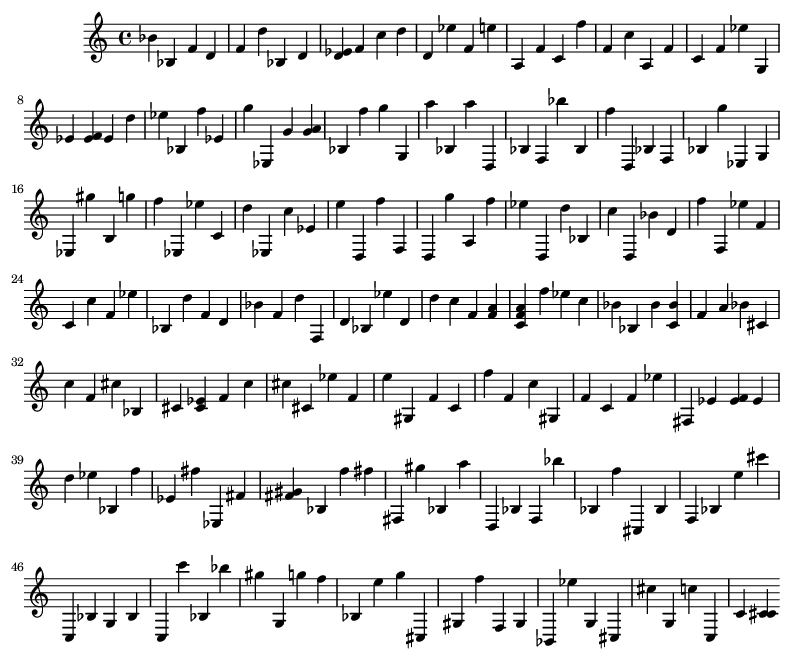

In [6]:
#Printing the music sheet
#First Lets write some functions that we need to look into the data
def show(music):
    print(type(Image(str(music.write("lily.png")))))
    display(Image(str(music.write("lily.png"))))

def chords_n_notes(Snippet):
    Melody = []
    offset = 0 #Incremental
    for i in Snippet:
        #If it is chord
        if ("." in i or i.isdigit()):
            chord_notes = i.split(".") #Seperating the notes in chord
            notes = [] 
            for j in chord_notes:
                inst_note=int(j)
                note_snip = note.Note(inst_note)            
                notes.append(note_snip)
                chord_snip = chord.Chord(notes)
                chord_snip.offset = offset
                Melody.append(chord_snip)
        # pattern is a note
        else: 
            note_snip = note.Note(i)
            note_snip.offset = offset
            Melody.append(note_snip)
        # increase offset each iteration so that notes do not stack
        offset += 1
    Melody_midi = stream.Stream(Melody)   
    return Melody_midi

Melody_Snippet = chords_n_notes(Corpus[:200])

show(Melody_Snippet)

#### Playing the above sheet music

To play music in python. <br/>
(1) First need to transfer stream.Stream object into midi file. <br/>
(2) give a soundfont file to assign timbre when rendering MIDI.<br/>
(3)Render MIDI into Wav format.<br/>
Converting MIDI to WAV format involves audio rendering, which is a relatively complex process. Here uses the midi2audio package (which uses FluidSynth under the hood).

In [7]:
Melody_Snippet.write('midi', fp='Melody_Snippet.mid')
#Melody_Snippet.write('midi', fp='Melody_Snippet.mid') 是一个命令，
#用于将 Melody_Snippet 这个音乐对象写入一个MIDI文件中，并将该文件保存在当前工作目录下，文件名为 "Melody_Snippet.mid"。

'Melody_Snippet.mid'

In [8]:
fs = FluidSynth('YDP-GrandPiano-20160804.sf2')#need a soundfont file to define the timbre used when rendering MIDI

In [9]:
# Play file in wav format
print("Press to play")
IPython.display.Audio("Melody_Snippet.wav") 

Press to play


In [10]:
fs.midi_to_audio('Melody_Snippet.mid', 'Melody_Snippet.wav')

fluidsynth: warning: No preset found on channel 9 [bank=128 prog=0]


FluidSynth runtime version 2.2.5
Copyright (C) 2000-2022 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'Melody_Snippet.wav'..


In [11]:
#Creating a count dictionary
count_num = Counter(Corpus)
print("Total unique notes in the Corpus:", len(count_num))

Total unique notes in the Corpus: 229


In [12]:
#Exploring the notes dictionary
#The purpose of this code is to explore the frequency of notes, calculate the average occurrence of all notes, 
#and identify the frequency of the most common and least common notes.
Notes = list(count_num.keys())
Recurrence = list(count_num.values())
#Average recurrence for a note in Corpus
def Average(lst):
    return sum(lst) / len(lst) #here lst can be any parameters
print("Average recurrence for a note in Corpus:", Average(Recurrence))
print("Most frequent note in Corpus appeared:", max(Recurrence), "times")
print("Least frequent note in Corpus appeared:", min(Recurrence), "time")


Average recurrence for a note in Corpus: 243.6768558951965
Most frequent note in Corpus appeared: 2355 times
Least frequent note in Corpus appeared: 1 time


In [13]:
print(Notes)

['B-4', 'B-3', 'F4', 'D4', 'D5', '2.3', 'C5', 'E-5', 'E5', 'A3', 'C4', 'F5', 'G3', '3.5', 'E-4', 'G5', 'E-3', '7.9', 'A5', 'D3', 'F3', 'B-5', 'G#5', 'B3', '5.9.0', '10.0', 'A4', 'C#4', 'C#5', '1.3', 'G#3', 'F#3', 'F#5', '6.8', 'C#3', 'C#6', 'C3', 'C6', 'B-2', '0.1', 'G#4', 'E4', 'G4', 'E3', '5.9', '4.7', '2.5', '1.4', '0.4', '10.2', '9.1', '9.0', '7.10', '6.9', '6.9.0.2', '9.10.0', '5.7', '4.5', '6.7', '10.2.5', 'D6', '7.10.2', '5.7.9', '0.3', '11.2', '8.9', '10.11', '9.10', '3.7', '2.6', '11.2.5.7', '3.5.7', 'B4', '4.5.7', '0.2', '11.0', '3.7.10', '0.3.7', '0.5', '10.0.2', 'F#4', '9.0.3', '10', '7.11', 'E6', 'B2', 'B5', 'G2', '8.11', 'E-6', 'F6', '0', '0.4.7', '4', '7', '4.9', '4.8', '11.4', '4.6', '11.2.6', '9.1.4', '8.11.2.4', 'E2', 'A2', '2.8', '3.6', '4.8.11', '9', '2.4.8', '11', '1', '2', '8.1', '2.4', '10.1', 'F#2', '11.1', 'G#2', '9.11', 'D2', 'A1', '9.2', '11.2.4', '3.6.9', 'B1', 'C#2', '3.9', '3.4', '11.3', '1.2', '3.8', '7.8', '6.11', '4.6.8', '11.1.2', '3', '5', '8', '6', '

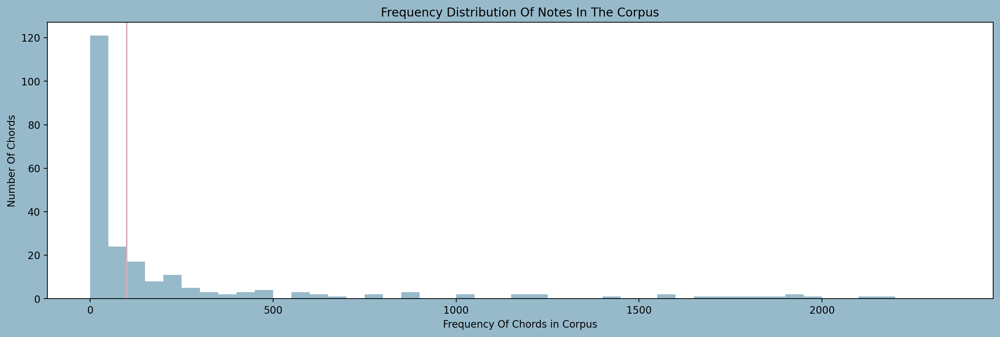

In [14]:
# Plotting the distribution of Notes
plt.figure(figsize=(17,5),facecolor="#97BACB")
bins = np.arange(0,(max(Recurrence)), 50) 
plt.hist(Recurrence, bins=bins, color="#97BACB")
plt.axvline(x=100,color="#DBACC1") # help to how many chords recur for over 100 times
plt.title("Frequency Distribution Of Notes In The Corpus")
plt.xlabel("Frequency Of Chords in Corpus")
plt.ylabel("Number Of Chords")
plt.show()

In [15]:
# notes that were played less than 100 times will be taken out
# The next steps create a list of rare notes in the next section.
#Getting a list of rare chords
#for index, (key, value) in enumerate(count_num.items()):
#这是一个循环，我们遍历count_num字典的所有项。'.items()'方法返回一个包含字典所有键值对的列表，
#enumerate()函数则会为这个列表中的每一个元素生成一个索引（即index），以及对应的键值对（即key, value）。
#例如，如果我们有一个字典my_dict = {'A': 10, 'B': 200, 'C': 50}，那么enumerate(my_dict.items())会生成一个对象，
#我们可以遍历这个对象，得到(0, ('A', 10))，(1, ('B', 200))，(2, ('C', 50))。
#'.items()' method returns a list containing all key-value pairs of dictionary 
#The enumerate() function will generate an index (ie index) and corresponding key-value pairs (ie key, value) for each element in the list.

rare_note = [] # create new list called 'rare_note'
for index, (key, value) in enumerate(count_num.items()):
    if value < 100:
        m =  key
        rare_note.append(m)
        
print("Total number of notes that occur less than 100 times:", len(rare_note))

Total number of notes that occur less than 100 times: 145


In [16]:
Corpus_clean = [note for note in Corpus if note not in rare_note]

print("Length of Corpus after eliminating the rare notes:", len(Corpus_clean))

Length of Corpus after eliminating the rare notes: 52722


##### **Creating a list of sorted unique characters**

In [17]:
# Storing all the unique characters present in my corpus to bult a mapping dic. 
symb = sorted(list(set(Corpus)))

L_corpus = len(Corpus) #length of corpus
L_symb = len(symb) #length of total unique characters

#Building dictionary to access the vocabulary from indices and vice versa
#to build dictionary of ‘key to valuedictionary’ and dictionary of ‘value to key’
mapping = dict((c, i) for i, c in enumerate(symb))
reverse_mapping = dict((i, c) for i, c in enumerate(symb))

print("Total number of characters:", L_corpus)
print("Number of unique characters:", L_symb)

Total number of characters: 55802
Number of unique characters: 229


In [18]:
mapping['7.10.0']

130

##### **Encoding and Splitting the Corpus as Labels and Targets**

In [19]:
#Splitting the Corpus in equal length of strings and output target
length = 40
features = [] # 这两行创建了两个空列表，分别用来存储训练数据的输入特征（即音符序列）和目标（即接下来的音符）。
targets = []
for i in range(0, L_corpus - length, 1):
    feature = Corpus[i:i + length]
    target = Corpus[i + length]
    features.append([mapping[j] for j in feature])
    targets.append(mapping[target])
    
    
L_datapoints = len(targets)
print("Total number of sequences in the Corpus:", L_datapoints)

Total number of sequences in the Corpus: 55762


In [20]:
# reshape X and normalize
X = (np.reshape(features, (L_datapoints, length, 1)))/ float(L_symb)
# one hot encode the output variable
y = tensorflow.keras.utils.to_categorical(targets) 

In [21]:
#Taking out a subset of data to be used as seed
X_train, X_seed, y_train, y_seed = train_test_split(X, y, test_size=0.2, random_state=42)

### **Model building**

**Following steps are involved in the model building**

· Initialising the Model<br/>
· Defining by adding layers<br/>
· Compiling the Model<br/>
· Training the Model<br/>

**1.Building the Model**

In [22]:
#Initialising the Model
model = Sequential()
#Adding layers
model.add(LSTM(512, input_shape=(X.shape[1], X.shape[2]), return_sequences=True)) #添加第一个长短时记忆（LSTM）层，其中有512个神经元。LSTM层通常用于处理序列数据。
#X shape is(L_datapoints, length, 1)，
#X.shape[1]and X.shape[2] means the second and the third feature of X shape，which are ‘length’and‘1’
#X的形状（shape）是指X这个数组在各个维度上的大小。在NumPy中，一个数组的形状可以通过其shape属性来访问，它是一个元组，其中包含了数组在每个维度上的大小。
#例如，如果X是一个三维数组，其中第一个维度有L_datapoints个元素，第二个维度有length个元素，第三个维度有1个元素，那么X的形状就是(L_datapoints, length, 1)。
model.add(Dropout(0.1))
model.add(LSTM(256))
model.add(Dense(256))
model.add(Dropout(0.1))
model.add(Dense(y.shape[1], activation='softmax'))
#Compiling the model for training  
opt = Adamax(learning_rate=0.01)
model.compile(loss='categorical_crossentropy', optimizer=opt)

2023-08-05 00:27:52.472886: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-05 00:27:52.525164: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-05 00:27:52.525253: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-05 00:27:52.532884: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-05 00:27:52.532992: I tensorflow/compile

In [23]:
#Model's Summary               
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 40, 512)           1052672   
                                                                 
 dropout (Dropout)           (None, 40, 512)           0         
                                                                 
 lstm_1 (LSTM)               (None, 256)               787456    
                                                                 
 dense (Dense)               (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 229)               58853     
                                                                 
Total params: 1964773 (7.50 MB)
Trainable params: 196477

In [24]:
#Training the Model
history = model.fit(X_train, y_train, batch_size=256, epochs=200)

Epoch 1/200


2023-08-05 00:27:57.000803: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 40861844 exceeds 10% of free system memory.
2023-08-05 00:27:57.118980: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 40861844 exceeds 10% of free system memory.
2023-08-05 00:28:05.162939: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8903
2023-08-05 00:28:09.963097: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-08-05 00:28:10.031877: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7f84efea3380 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-08-05 00:28:10.031917: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3070 Ti Laptop GPU, Compute Capability 8.6
2023-08-05 00:28:10.101012: I tensorflow/compiler/mlir/tens

175/175 [==============================] - 19s 25ms/step - loss: 4.3753
Epoch 2/200
175/175 [==============================] - 4s 24ms/step - loss: 4.2692
Epoch 3/200
175/175 [==============================] - 4s 24ms/step - loss: 4.2576
Epoch 4/200
175/175 [==============================] - 4s 24ms/step - loss: 4.2488
Epoch 5/200
175/175 [==============================] - 4s 24ms/step - loss: 4.2514
Epoch 6/200
175/175 [==============================] - 4s 23ms/step - loss: 4.2464
Epoch 7/200
175/175 [==============================] - 4s 23ms/step - loss: 4.2447
Epoch 8/200
175/175 [==============================] - 4s 23ms/step - loss: 4.2441
Epoch 9/200
175/175 [==============================] - 4s 24ms/step - loss: 4.2402
Epoch 10/200
175/175 [==============================] - 4s 23ms/step - loss: 4.2391
Epoch 11/200
175/175 [==============================] - 4s 24ms/step - loss: 4.2386
Epoch 12/200
175/175 [==============================] - 4s 24ms/step - loss: 4.2365
Epoch 13/200

In [25]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [26]:
print(tf.__version__)

2.13.0


## Evaluate

**Plotting the learning curve for the loss function**

[Text(0.5, 0, 'Epochs')]

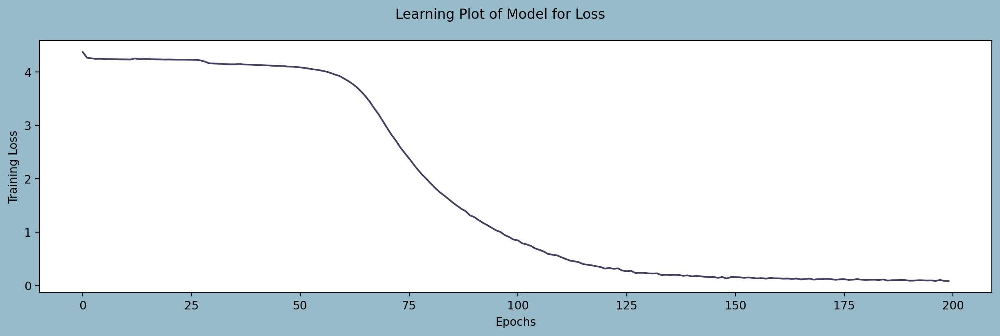

In [27]:
#Plotting the learnings 
history_df = pd.DataFrame(history.history)
fig = plt.figure(figsize=(15,4), facecolor="#97BACB")
fig.suptitle("Learning Plot of Model for Loss")
pl=sns.lineplot(data=history_df["loss"],color="#444160")
pl.set(ylabel ="Training Loss")
pl.set(xlabel ="Epochs")

**Generating the Melody**

Changing working directory to: `/tmp/music21'
Processing `/tmp/music21/tmpckkk1ihz.ly'
Parsing...
Interpreting music...[8][16][24][32]
Preprocessing graphical objects...
Calculating line breaks... 
Drawing systems... 
Layout output to `tmpckkk1ihz.ly.eps'...
Converting to PNG...
Layout output to `tmpckkk1ihz.ly-1.eps'...
Layout output to `tmpckkk1ihz.ly-2.eps'...
Layout output to `tmpckkk1ihz.ly-3.eps'...
Layout output to `tmpckkk1ihz.ly-4.eps'...
Writing tmpckkk1ihz.ly-systems.texi...
Writing tmpckkk1ihz.ly-systems.tex...
Writing tmpckkk1ihz.ly-systems.count...
Success: compilation successfully completed


<class 'IPython.core.display.Image'>


Changing working directory to: `/tmp/music21'
Processing `/tmp/music21/tmp3ghzj32a.ly'
Parsing...
Interpreting music...[8][16][24][32]
Preprocessing graphical objects...
Calculating line breaks... 
Drawing systems... 
Layout output to `tmp3ghzj32a.ly.eps'...
Converting to PNG...
Layout output to `tmp3ghzj32a.ly-1.eps'...
Layout output to `tmp3ghzj32a.ly-2.eps'...
Layout output to `tmp3ghzj32a.ly-3.eps'...
Layout output to `tmp3ghzj32a.ly-4.eps'...
Writing tmp3ghzj32a.ly-systems.texi...
Writing tmp3ghzj32a.ly-systems.tex...
Writing tmp3ghzj32a.ly-systems.count...
Success: compilation successfully completed


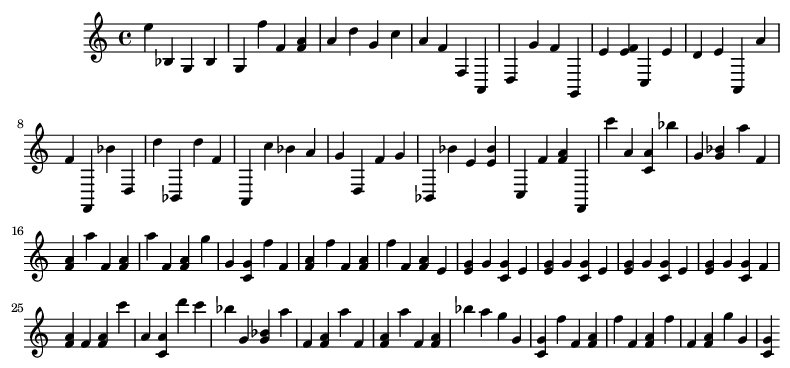

In [28]:
def Malody_Generator(Note_Count):
    seed = X_seed[np.random.randint(0,len(X_seed)-1)]
    Music = ""
    Notes_Generated=[]
    for i in range(Note_Count):
        seed = seed.reshape(1,length,1)
        prediction = model.predict(seed, verbose=0)[0]
        prediction = np.log(prediction) / 1.0 #diversity
        exp_preds = np.exp(prediction)
        prediction = exp_preds / np.sum(exp_preds)
        index = np.argmax(prediction)
        index_N = index/ float(L_symb)   
        Notes_Generated.append(index)
        Music = [reverse_mapping[char] for char in Notes_Generated]
        seed = np.insert(seed[0],len(seed[0]),index_N)
        seed = seed[1:]
    #Now, we have music in form or a list of chords and notes and we want to be a midi file.
    Melody = chords_n_notes(Music)
    Melody_midi = stream.Stream(Melody)   
    return Music,Melody_midi


#getting the Notes and Melody created by the model
Music_notes, Melody = Malody_Generator(100)
show(Melody)

In [32]:
#getting the Notes and Melody created by the model
Music_notes, Melody_sample1 = Malody_Generator(100)

fs = FluidSynth('YDP-GrandPiano-20160804.sf2')
fs.midi_to_audio('Melody_Generated.mid', 'Melody_sample1.wav')
# Play file in wav format
print("Press to play")
IPython.display.Audio("Melody_sample1.wav") 

fluidsynth: warning: No preset found on channel 9 [bank=128 prog=0]


FluidSynth runtime version 2.2.5
Copyright (C) 2000-2022 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'Melody_sample1.wav'..
Press to play
